In [62]:
import sys
sys.path = [p for p in sys.path if "ParaView" not in p]


import torch as pt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.tri as mtri
from flowtorch import DATASETS
from flowtorch.data import FOAMDataloader, mask_box
from pydmd import DMD, ParametricDMD
from ezyrb import POD, Database, RBF, GPR, Linear

from pathlib import Path
import re
# For High Quality Visuals
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 160  # crisp visuals


In [74]:
# Parameters
Re_list = [ 200, 400, 600, 800]  # Reynolds numbers


In [106]:
# Load and prepare data

# Base path to simulation folders
base_path = Path("~/OpenFOAM/run").expanduser()
Re_folders = {Re: base_path / f"cylinder_2D_Re{Re}" for Re in Re_list}

# Sampling step for downsampling snapshots
sampling_step = 5

# Dictionaries to store all relevant data
snapshot_dict = {}
sampled_times_dict = {}
mask_dict = {}
num_points_dict = {}
loader_dict = {}

# Additional dictionaries for future-time snapshots (15.0–20.0)
snapshot_future_dict = {}
sampled_times_future_dict = {}

# Function to load and mask velocity snapshots
def load_masked_matrix(loader, mask, times):
    num_points = mask.sum().item()
    num_times = len(times)
    data_matrix = pt.zeros((2 * num_points, num_times), dtype=pt.float64)

    for i, time in enumerate(times):
        snapshot = loader.load_snapshot("U", time)
        ux_masked = pt.masked_select(snapshot[:, 0], mask)
        uy_masked = pt.masked_select(snapshot[:, 1], mask)
        data_matrix[:num_points, i] = ux_masked
        data_matrix[num_points:, i] = uy_masked

    return data_matrix.numpy(), num_points

# Loop through each Re and load data
for Re in Re_list:
    folder = Re_folders[Re]
    loader = FOAMDataloader(str(folder))
    times = loader.write_times

    # Filter and downsample time steps for training (10.0–15.0)
    window_times = [t for t in times if 1.0 <= float(t) <= 15.0]
    sampled_times = window_times[::sampling_step]

    # Create spatial mask for cylinder region
    vertices = loader.vertices[:, :2]
    mask = mask_box(vertices, lower=[0.1, -1], upper=[0.75, 1])

    # Load masked velocity snapshots for training
    data_matrix, num_points = load_masked_matrix(loader, mask, sampled_times)

    # Store training data
    snapshot_dict[Re] = data_matrix
    sampled_times_dict[Re] = sampled_times
    mask_dict[Re] = mask
    num_points_dict[Re] = num_points
    loader_dict[Re] = loader

    # Optional: Load future snapshots for validation/forecasting (15.0–20.0)
    future_window_times = [t for t in times if 15.0 <= float(t) <= 20.0]
    sampled_future_times = future_window_times[::sampling_step]

    if sampled_future_times:
        future_data_matrix, _ = load_masked_matrix(loader, mask, sampled_future_times)
        snapshot_future_dict[Re] = future_data_matrix
        sampled_times_future_dict[Re] = sampled_future_times

print("✅ Data loaded for Reynolds numbers:", Re_list)


INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant


✅ Data loaded for Reynolds numbers: [200, 400, 600, 800]


In [107]:
# Print the maximum velocity for each Reynolds number

for Re in Re_list:
    print(f"Re={Re}, max velocity =", np.max(snapshot_dict[Re]))

Re=200, max velocity = 3.7424089908599854
Re=400, max velocity = 8.080679893493652
Re=600, max velocity = 12.436511993408203
Re=800, max velocity = 16.850170135498047


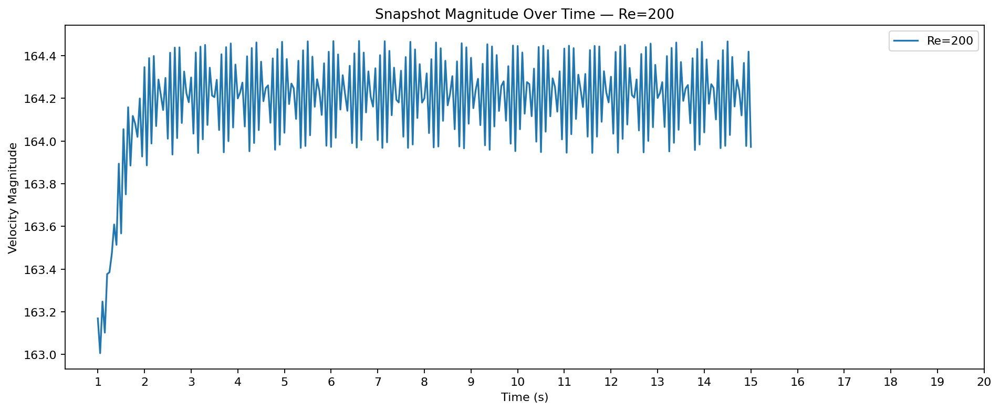

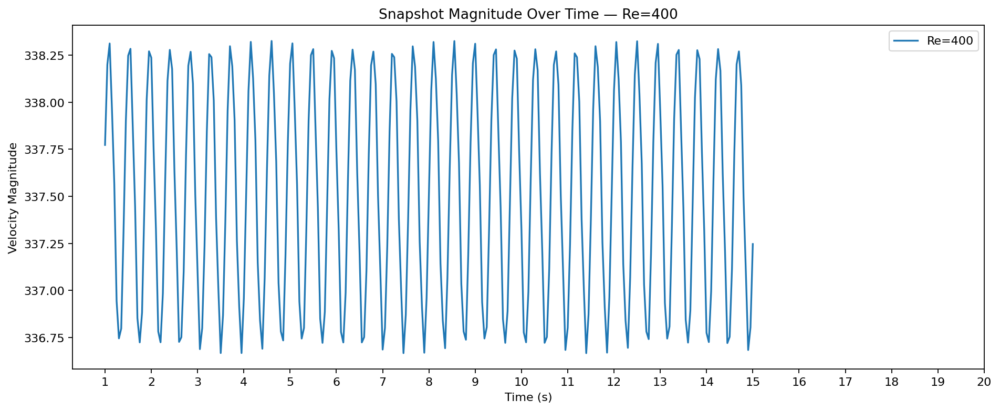

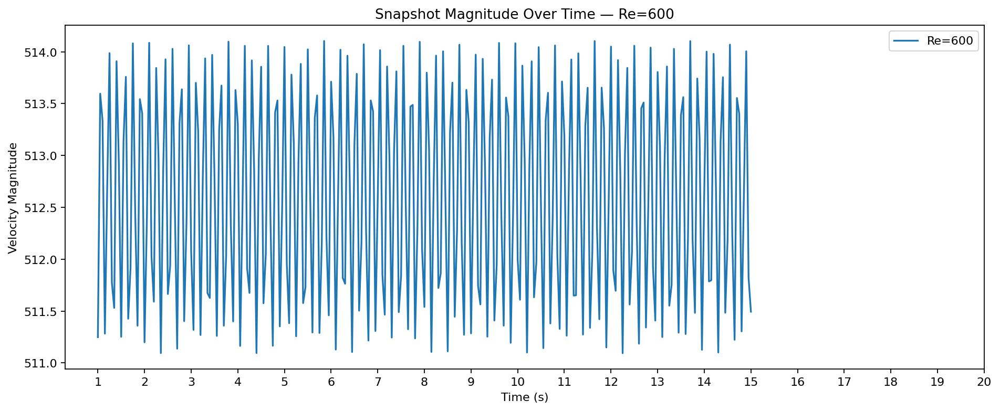

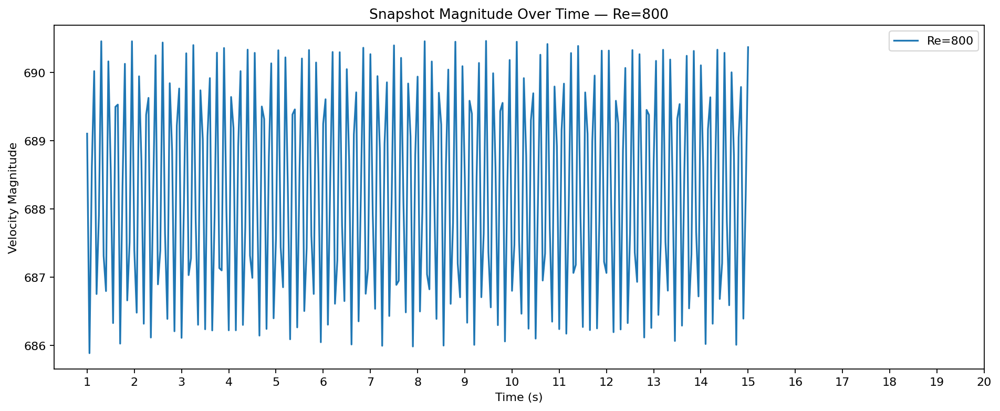

In [108]:
# Plot the snapshot magnitudes over time for each Re

for Re in Re_list:
    fig, ax = plt.subplots(figsize=(12, 5))  # Create a new figure for each Re

    mags = np.linalg.norm(snapshot_dict[Re], axis=0)
    times = np.array(sampled_times_dict[Re], dtype=float)

    ax.plot(times, mags, label=f"Re={Re}", color='tab:blue')

    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Velocity Magnitude")
    ax.set_title(f"Snapshot Magnitude Over Time — Re={Re}")
    ax.legend()

    # Set ticks every 1 second from 1 to 20
    ax.set_xticks(np.arange(1, 21, 1))

    plt.tight_layout()
    plt.show()


In [109]:
# Print the loaded data matrix shape for each Reynolds number
print("Data_matrix shape for each Re:",data_matrix.shape)

Data_matrix shape for each Re: (11492, 281)


## Offline Phase

## Step 1: Perform POD on the concatenated snapshot matrix X1

In [110]:
# Step 1: Perform POD on concatenated snapshot data

# Stack all snapshot matrices across Reynolds numbers
all_data = np.hstack([snapshot_dict[Re] for Re in Re_list])  # shape: (2*num_points, total_time)

# Compute POD basis
pod = POD(rank=30)  
pod.fit(all_data)

# Project each snapshot matrix into reduced space
reduced_snapshots = {Re: pod.transform(snapshot_dict[Re]) for Re in Re_list}

# Print shape to verify
for Re in Re_list:
    print(f"Re = {Re}, Reduced shape = {reduced_snapshots[Re].shape}")


Re = 200, Reduced shape = (30, 281)
Re = 400, Reduced shape = (30, 281)
Re = 600, Reduced shape = (30, 281)
Re = 800, Reduced shape = (30, 281)


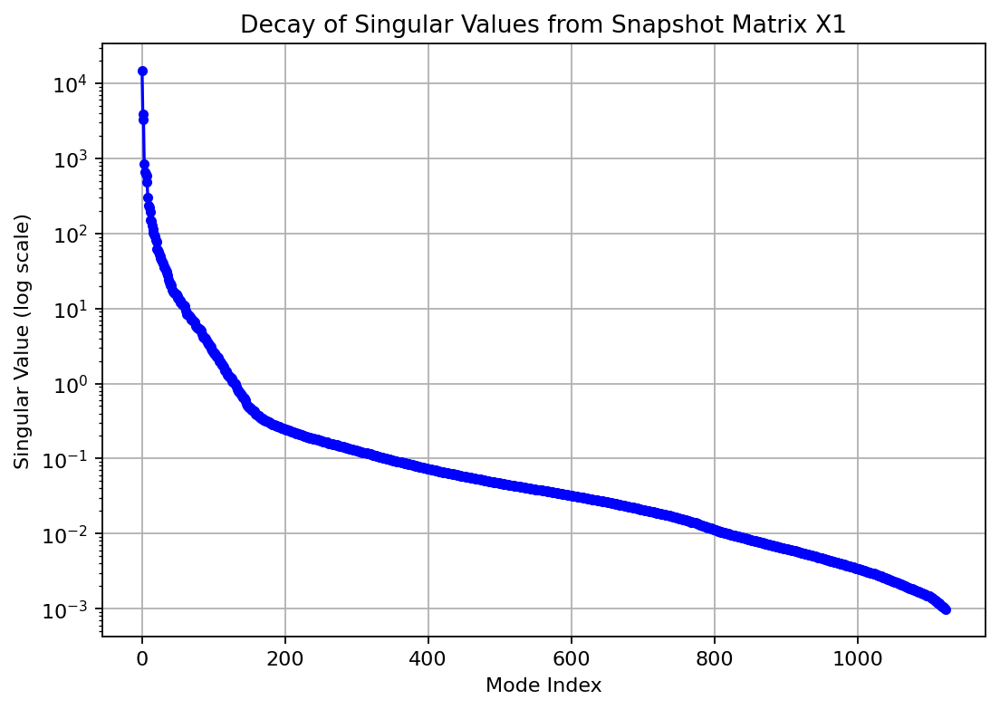

In [111]:
# Singular value decay plot for the snapshot matrix X1


U, S, Vh = np.linalg.svd(all_data, full_matrices=False)

plt.figure(figsize=(7, 5))
plt.semilogy(S, 'bo-', markersize=4)
plt.title("Decay of Singular Values from Snapshot Matrix X1")
plt.xlabel("Mode Index")
plt.ylabel("Singular Value (log scale)")
plt.grid(True)
plt.tight_layout()
plt.show()

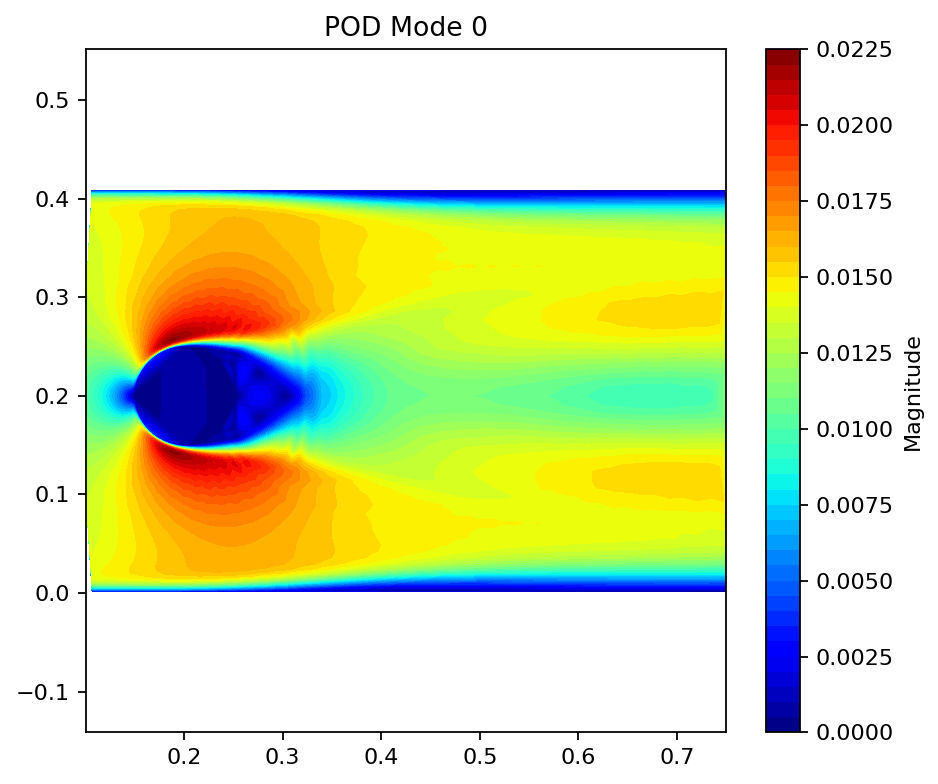

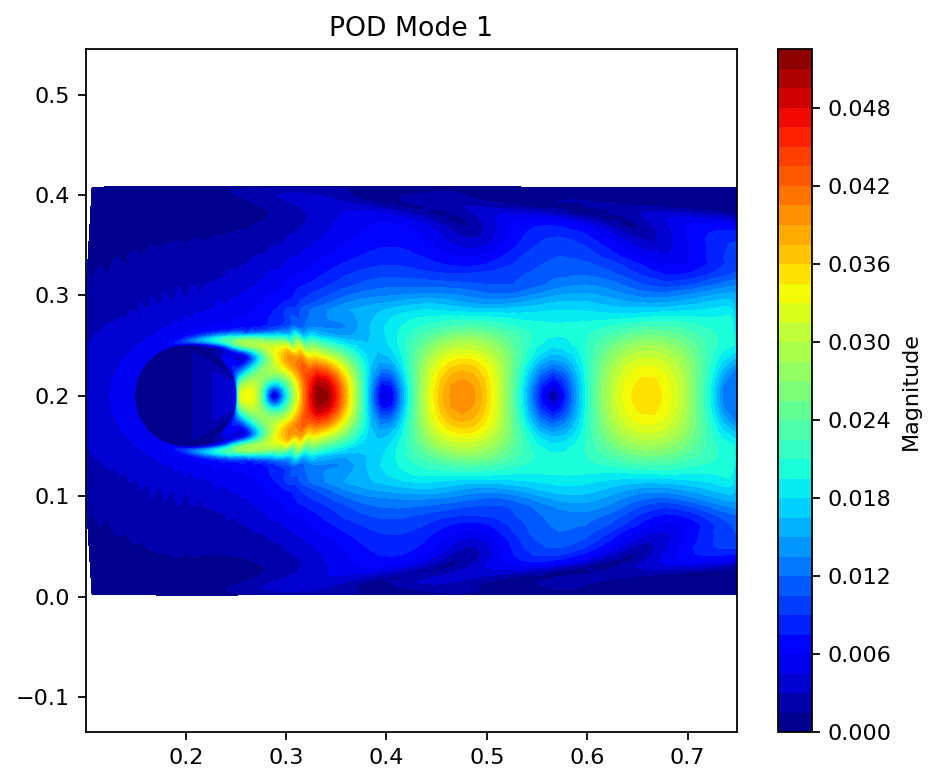

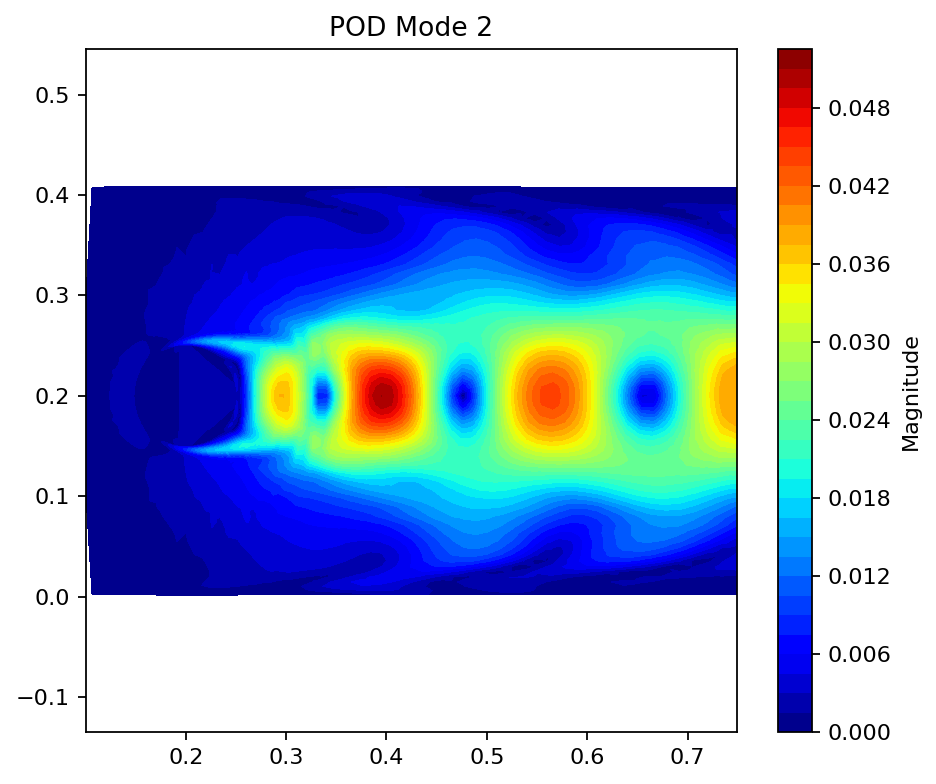

In [112]:
# POD modes of the global snapshot matrix 

mode_indices = [0, 1, 2]  # First three POD modes

# Get masked vertices (2D points)
coords = vertices[mask.numpy(), :]
tri = mtri.Triangulation(coords[:, 0], coords[:, 1])

for idx in mode_indices:
    mode = pod.modes[:, idx]
    ux_mode = mode[:num_points]
    uy_mode = mode[num_points:]
    velocity_magnitude = np.sqrt(ux_mode**2 + uy_mode**2)
    
    plt.figure(figsize=(6, 5))
    plt.tricontourf(tri, velocity_magnitude, levels=50, cmap='jet')
    plt.title(f"POD Mode {idx}")
    plt.colorbar(label="Magnitude")
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

## Step 2: Partioned DMD 

In [113]:
# Step 2: Partitioned DMD on reduced snapshots

# Dictionary to store DMD models per Reynolds number
dmd_models = {}

# Apply DMD separately for each Reynolds number
for Re in Re_list:
    snapshot = reduced_snapshots[Re]  # shape: (r, N)
    dmd = DMD(svd_rank=30)
    dmd.fit(snapshot)
    dmd_models[Re] = dmd

    print(f"DMD model for Re={Re} fitted. Modes shape: {dmd.modes.shape}, Eigenvalues count: {len(dmd.eigs)}")



INFO:root:Snapshots: (30, 281), snapshot shape: (30,)
/home/haseeb/ml-cfd-lecture/ml-cfd/lib/python3.12/site-packages/pydmd/snapshots.py:73: UserWarning: Input data condition number 314388.8127592169. Consider preprocessing data, passing in augmented data
matrix, or regularization methods.
  warnings.warn(
INFO:root:Snapshots: (30, 281), snapshot shape: (30,)
/home/haseeb/ml-cfd-lecture/ml-cfd/lib/python3.12/site-packages/pydmd/snapshots.py:73: UserWarning: Input data condition number 112635.25863073245. Consider preprocessing data, passing in augmented data
matrix, or regularization methods.
  warnings.warn(
INFO:root:Snapshots: (30, 281), snapshot shape: (30,)
INFO:root:Snapshots: (30, 281), snapshot shape: (30,)


DMD model for Re=200 fitted. Modes shape: (30, 30), Eigenvalues count: 30
DMD model for Re=400 fitted. Modes shape: (30, 30), Eigenvalues count: 30
DMD model for Re=600 fitted. Modes shape: (30, 30), Eigenvalues count: 30
DMD model for Re=800 fitted. Modes shape: (30, 30), Eigenvalues count: 30


## Step 3: Stabilize the DMD models 

In [114]:
# Step 3: Stabilize each DMD model separately
stabilized_models = {}

for Re in Re_list:
    dmd = dmd_models[Re]
    Phi = dmd.modes
    Lambda = dmd.eigs
    b = dmd.amplitudes

    # Stabilization: retain only eigenvalues near unit circle
    epsilon = 1e-2  # tolerance for marginal stability
    stable_indices = np.where(np.abs(np.abs(Lambda) - 1) < epsilon)[0]

    # Normalize eigenvalues to unit circle
    Lambda_stable = Lambda[stable_indices] / np.abs(Lambda[stable_indices])
    Phi_stable = Phi[:, stable_indices]
    b_stable = b[stable_indices]

    # Store stabilized components
    stabilized_models[Re] = (Phi_stable, Lambda_stable, b_stable)



In [115]:
# Evaluate energy retention after DMD stabilization

energy_total = np.sum(np.abs(b)**2)
energy_stable = np.sum(np.abs(b_stable)**2)
print(f"Energy retained: {energy_stable / energy_total:.2%}")


Energy retained: 100.00%


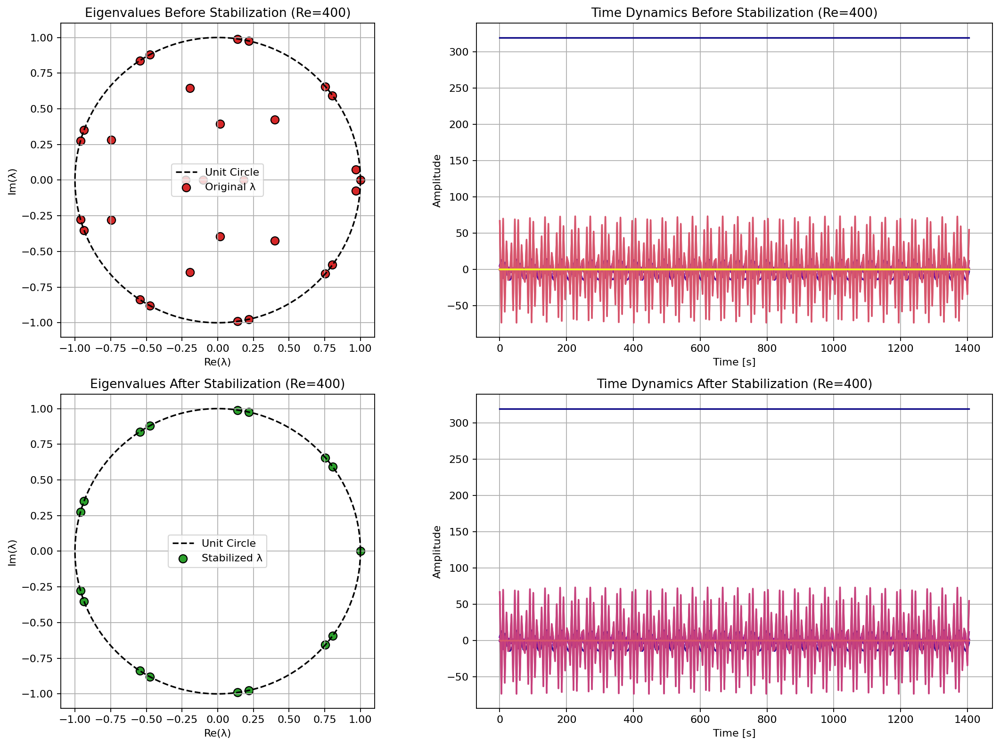

In [116]:
# Eigenvalue & Time‐Dynamics before and after stabilization plot

# Choose a Reynolds number to visualize
Re_target = Re_list[1]  # or any specific Re you want to plot

# Retrieve original and stabilized components
dmd = dmd_models[Re_target]
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_target]

# Original eigenvalues
eigs_original = dmd.eigs
eigs_stabilized = Lambda_stable

# Time vector
num_snapshots = dmd.dynamics.shape[1]
times_num = np.linspace(0, num_snapshots * sampling_step, num_snapshots)

# Stabilized time dynamics
stabilized_dynamics = np.array([
    b_stable[i] * Lambda_stable[i]**np.arange(num_snapshots)
    for i in range(len(Lambda_stable))
])

# Prepare unit circle
theta = np.linspace(0, 2 * np.pi, 300)
unit_circle = np.exp(1j * theta)

# Create figure
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
colors = plt.cm.plasma(np.linspace(0, 1, max(len(dmd.dynamics), len(stabilized_dynamics))))

# Top-Left: Eigenvalues BEFORE stabilization
ax = axes[0, 0]
ax.plot(unit_circle.real, unit_circle.imag, 'k--', lw=1.5, label="Unit Circle")
ax.scatter(eigs_original.real, eigs_original.imag, c='tab:red', edgecolors='black', s=60, label="Original λ")
ax.set_title(f"Eigenvalues Before Stabilization (Re={Re_target})")
ax.set_xlabel("Re(λ)")
ax.set_ylabel("Im(λ)")
ax.set_aspect('equal')
ax.grid(True)
ax.legend()

# Bottom-Left: Eigenvalues AFTER stabilization
ax = axes[1, 0]
ax.plot(unit_circle.real, unit_circle.imag, 'k--', lw=1.5, label="Unit Circle")
ax.scatter(eigs_stabilized.real, eigs_stabilized.imag, c='tab:green', edgecolors='black', s=60, label="Stabilized λ")
ax.set_title(f"Eigenvalues After Stabilization (Re={Re_target})")
ax.set_xlabel("Re(λ)")
ax.set_ylabel("Im(λ)")
ax.set_aspect('equal')
ax.grid(True)
ax.legend()

# Top-Right: Time Dynamics BEFORE stabilization
ax = axes[0, 1]
for i, dyn in enumerate(dmd.dynamics):
    ax.plot(times_num, dyn.real, lw=1.5, color=colors[i])
ax.set_title(f"Time Dynamics Before Stabilization (Re={Re_target})")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")
ax.grid(True)

# Bottom-Right: Time Dynamics AFTER stabilization
ax = axes[1, 1]
for i in range(stabilized_dynamics.shape[0]):
    ax.plot(times_num, stabilized_dynamics[i].real, lw=1.5, color=colors[i])
ax.set_title(f"Time Dynamics After Stabilization (Re={Re_target})")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")
ax.grid(True)

plt.tight_layout()
plt.show()


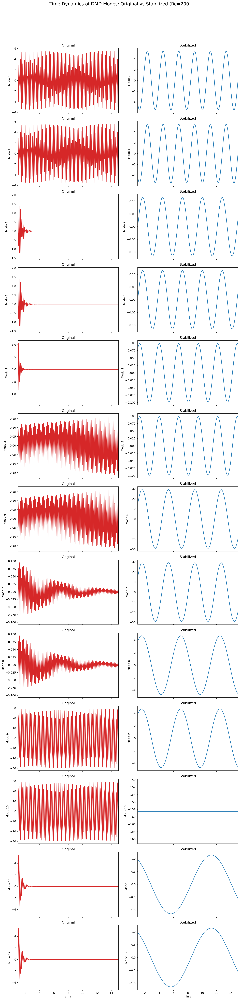

In [117]:
# Time dynamics of the retained DMD modes Original vs stabilized

# Choose a Reynolds number to visualize
Re_input = Re_list[0]  # or any specific Re value

# Retrieve original and stabilized components
dmd = dmd_models[Re_input]
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_input]

# Convert time array
times_num = [float(t) for t in sampled_times]
t_min, t_max = min(times_num), max(times_num)
time_steps = len(times_num)

# Stabilized time dynamics
stabilized_dynamics = np.array([
    b_stable[i] * Lambda_stable[i]**np.array(times_num)
    for i in range(len(Lambda_stable))
])

# Number of modes to compare
num_modes = stabilized_dynamics.shape[0]
modes = list(range(num_modes))

# Create subplot grid: rows = modes, cols = original vs stabilized
fig, axarr = plt.subplots(num_modes, 2, figsize=(12, 4 * num_modes), sharex=True)

# Ensure axarr is always 2D
if num_modes == 1:
    axarr = np.array([axarr])

for i, m in enumerate(modes):
    # Original dynamics (if available)
    if m < len(dmd.dynamics):
        signal_orig = dmd.dynamics[m].real[:time_steps]
        axarr[i][0].plot(times_num, signal_orig, lw=1.5, color='tab:red')
    else:
        axarr[i][0].text(0.5, 0.5, "Not available", ha='center', va='center')
    axarr[i][0].set_ylabel(f"Mode {m}")
    axarr[i][0].set_title("Original")

    # Stabilized dynamics
    signal_stab = stabilized_dynamics[m].real
    axarr[i][1].plot(times_num, signal_stab, lw=1.5, color='tab:blue')
    axarr[i][1].set_title("Stabilized")
    axarr[i][1].set_ylabel(f"Mode {m}")

# Final styling
for ax in axarr[-1]:
    ax.set_xlabel(r"$t$ in $s$")
    ax.set_xlim(t_min, t_max)

fig.suptitle(f"Time Dynamics of DMD Modes: Original vs Stabilized (Re={Re_input})", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


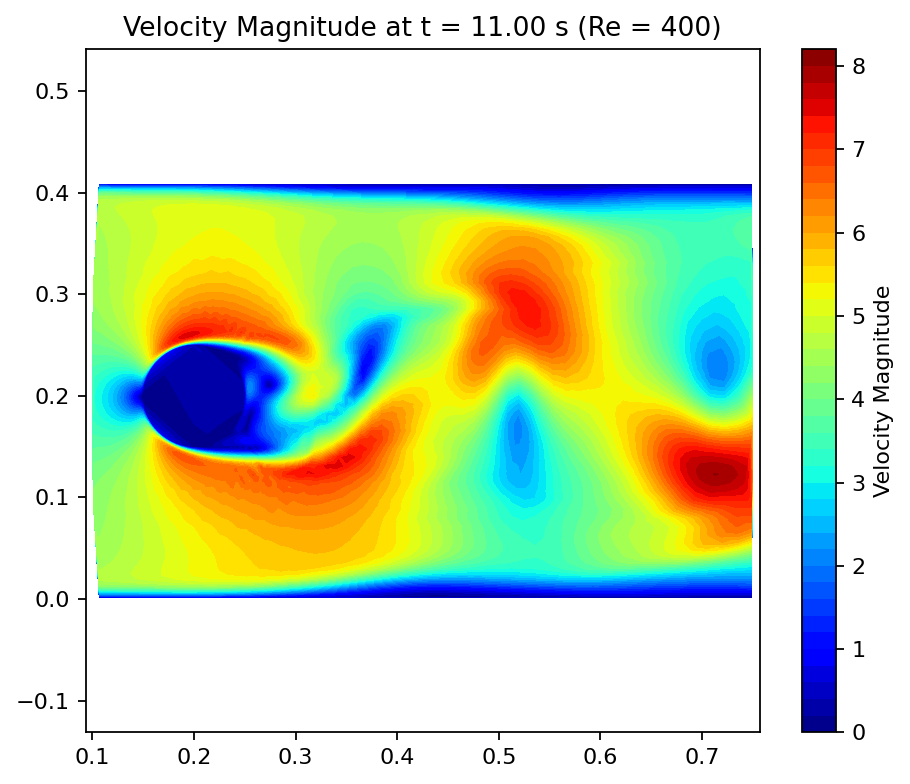

In [118]:

# Velocity Magnitude at Arbitrary Time for Re_input

# Parameters
Re_input = 400
t_target = 11.0  # Must be within training window: 10.0–15.0

# Use actual snapshot index from training data
sampled_times_float = [float(t) for t in sampled_times_dict[Re_input]]
if t_target not in sampled_times_float:
    raise ValueError(f"t_target = {t_target} not in training window. Choose from: {sampled_times_float}")

# Find index of t_target
target_index = sampled_times_float.index(t_target)

# Get reduced snapshot directly from training data
snapshot_reduced_t = reduced_snapshots[Re_input][:, target_index]
snapshot_reduced_t = np.real(snapshot_reduced_t)

# Reconstruct full snapshot using POD
snapshot_full_t = pod.inverse_transform(snapshot_reduced_t)

# Split into velocity components
num_points = num_points_dict[Re_input]
ux = snapshot_full_t[:num_points]
uy = snapshot_full_t[num_points:]
velocity_magnitude = np.sqrt(ux**2 + uy**2)

# Plot velocity magnitude
coords = loader_dict[Re_input].vertices[mask_dict[Re_input].numpy(), :]
tri = mtri.Triangulation(coords[:, 0], coords[:, 1])
plt.figure(figsize=(6, 5))
plt.tricontourf(tri, velocity_magnitude, levels=50, cmap='jet')
plt.colorbar(label='Velocity Magnitude')
plt.title(f"Velocity Magnitude at t = {t_target:.2f} s (Re = {Re_input})")
plt.axis('equal')
plt.tight_layout()
plt.show()




## Visualize true vs reconstructed velocity magnitude of raw DMD for the "input parameters"

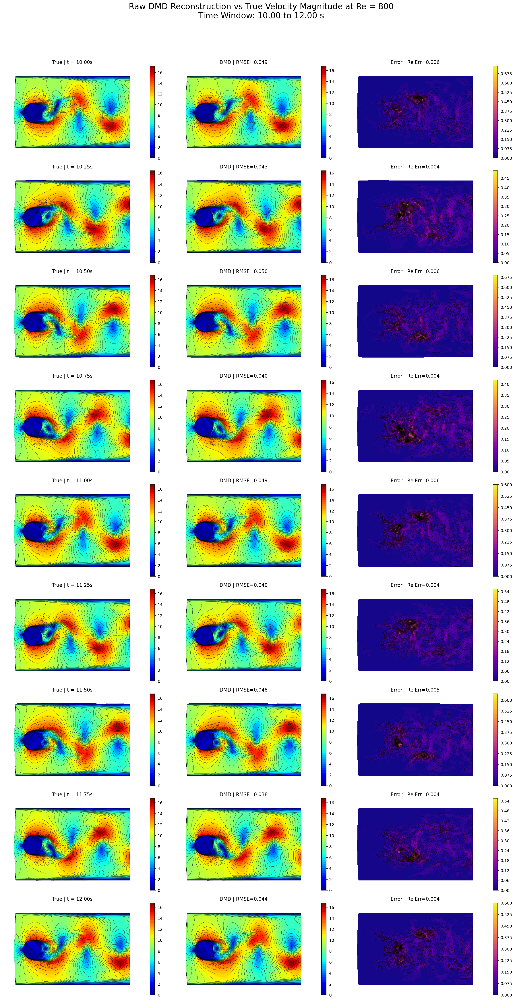

In [121]:

# Parameters
Re_target = 800
t_start = 10.0
t_end = 12.0
granularity = 5  # Plot every nth time step

# Load data
true_field = snapshot_dict[Re_target]  # shape: (2*num_points, num_times)
reduced_field = dmd_models[Re_target].reconstructed_data.real  # shape: (r, num_times)
num_points = num_points_dict[Re_target]
coords = loader_dict[Re_target].vertices[:, :2][mask_dict[Re_target].numpy()]
times = [float(t) for t in sampled_times_dict[Re_target]]

# Filter time steps
filtered_indices = [i for i, t in enumerate(times) if t_start <= t <= t_end][::granularity]
filtered_times = [times[i] for i in filtered_indices]

# Triangulation for plotting
triang = mtri.Triangulation(coords[:, 0], coords[:, 1])

# Plot setup
fig, axes = plt.subplots(len(filtered_indices), 3, figsize=(18, 4 * len(filtered_indices)))
fig.suptitle(f"Raw DMD Reconstruction vs True Velocity Magnitude at Re = {Re_target}\nTime Window: {t_start:.2f} to {t_end:.2f} s", fontsize=20)

for row, i in enumerate(filtered_indices):
    t = times[i]

    # True velocity components
    u_x_true = true_field[:num_points, i]
    u_y_true = true_field[num_points:, i]

    # Invert POD to get full-field DMD reconstruction
    reduced_snapshot = reduced_field[:, i].reshape(-1, 1)  # shape: (r, 1)
    full_snapshot = pod.inverse_transform(reduced_snapshot).reshape(2 * num_points)  # shape: (2*num_points,)
    u_x_dmd = full_snapshot[:num_points]
    u_y_dmd = full_snapshot[num_points:]

    # Compute magnitudes and error
    mag_true = np.sqrt(u_x_true**2 + u_y_true**2)
    mag_dmd = np.sqrt(u_x_dmd**2 + u_y_dmd**2)
    mag_err = np.abs(mag_true - mag_dmd)

    # Error metrics
    rmse = np.sqrt(np.mean((mag_true - mag_dmd)**2))
    rel_err = np.mean(mag_err / (mag_true + 1e-8))  # avoid division by zero

    # Plot each column
    for col, (data, title, cmap) in enumerate(zip(
        [mag_true, mag_dmd, mag_err],
        [f"True | t = {t:.2f}s",
         f"DMD | RMSE={rmse:.3f}",
         f"Error | RelErr={rel_err:.3f}"],
        ["jet", "jet", "plasma"]
    )):
        ax = axes[row, col]
        contour = ax.tricontourf(triang, data, levels=50, cmap=cmap)
        ax.tricontour(triang, data, levels=30, linewidths=0.3, colors='k')
        ax.set_title(title, fontsize=12)
        ax.axis('equal')
        ax.axis('off')
        fig.colorbar(contour, ax=ax)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


## Visualize true vs reconstructed velocity magnitude of stabilized DMD for the "input parameters"

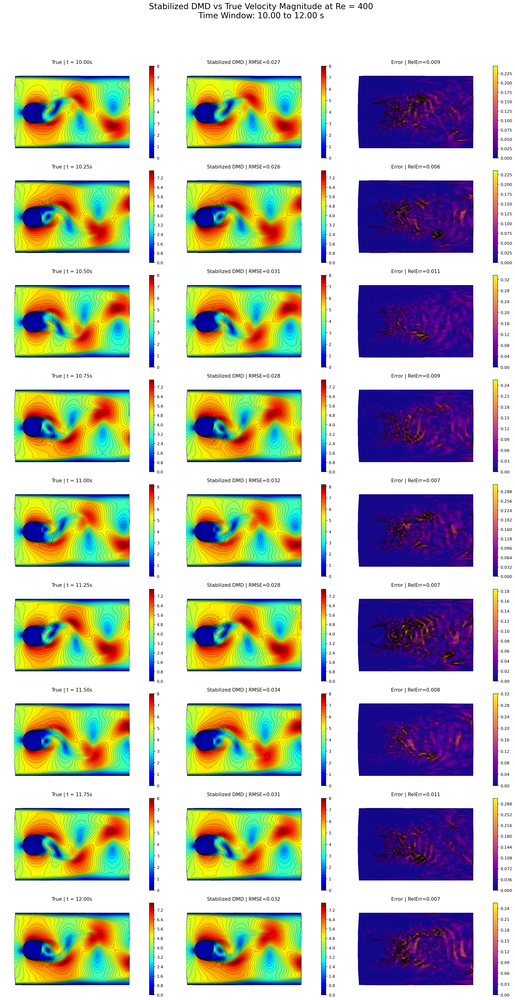

In [122]:
# Parameters
Re_target = 400
t_start = 10.0
t_end = 12.0
granularity = 5  # Plot every nth time step

# Load true data
true_field = snapshot_dict[Re_target]
num_points = num_points_dict[Re_target]
coords = loader_dict[Re_target].vertices[:, :2][mask_dict[Re_target].numpy()]
times = [float(t) for t in sampled_times_dict[Re_target]]

# Stabilized DMD components
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_target]

# Time normalization for forecasting
t0 = times[0]
dt = times[1] - times[0]
normalized_times = [(t - t0) / dt for t in times]
filtered_indices = [i for i, t in enumerate(times) if t_start <= t <= t_end][::granularity]
filtered_times = [times[i] for i in filtered_indices]

# Triangulation for plotting
triang = mtri.Triangulation(coords[:, 0], coords[:, 1])

# Plot setup
fig, axes = plt.subplots(len(filtered_indices), 3, figsize=(18, 4 * len(filtered_indices)))
fig.suptitle(f"Stabilized DMD vs True Velocity Magnitude at Re = {Re_target}\nTime Window: {t_start:.2f} to {t_end:.2f} s", fontsize=20)

for row, i in enumerate(filtered_indices):
    t = times[i]
    tau = normalized_times[i]

    # Forecast reduced snapshot using stabilized DMD
    coeffs_stable = b_stable * (Lambda_stable ** tau)
    reduced_snapshot = coeffs_stable.reshape(-1, 1)
    full_snapshot = pod.inverse_transform(np.real(Phi_stable @ reduced_snapshot)).reshape(2 * num_points)
    u_x_dmd = full_snapshot[:num_points]
    u_y_dmd = full_snapshot[num_points:]

    # True velocity components
    u_x_true = true_field[:num_points, i]
    u_y_true = true_field[num_points:, i]

    # Compute magnitudes and error
    mag_true = np.sqrt(u_x_true**2 + u_y_true**2)
    mag_dmd = np.sqrt(u_x_dmd**2 + u_y_dmd**2)
    mag_err = np.abs(mag_true - mag_dmd)

    # Error metrics
    rmse = np.sqrt(np.mean((mag_true - mag_dmd)**2))
    rel_err = np.mean(mag_err / (mag_true + 1e-8))

    # Plot each column
    for col, (data, title, cmap) in enumerate(zip(
        [mag_true, mag_dmd, mag_err],
        [f"True | t = {t:.2f}s",
         f"Stabilized DMD | RMSE={rmse:.3f}",
         f"Error | RelErr={rel_err:.3f}"],
        ["jet", "jet", "plasma"]
    )):
        ax = axes[row, col]
        contour = ax.tricontourf(triang, data, levels=50, cmap=cmap)
        ax.tricontour(triang, data, levels=30, linewidths=0.3, colors='k')
        ax.set_title(title, fontsize=12)
        ax.axis('equal')
        ax.axis('off')
        fig.colorbar(contour, ax=ax)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

## Online Phase

# Step 4: Forecasting & Interpolation for Unseen time and Reynolds number   

## Forecasting and visualization for the Reynolds numbers in the DMD models training list

In [123]:
def forecast_trained_velocity_fields(Re_query_val, stabilized_models, pod, sampled_times_future_dict, sampled_times_dict):
    if Re_query_val not in stabilized_models:
        raise ValueError(f"Re = {Re_query_val} is not a trained Reynolds number. Choose from: {list(stabilized_models.keys())}")

    # Load trained DMD components
    Phi, Lambda, b = stabilized_models[Re_query_val]

    # Time grid
    t_forecast = [float(t) for t in sampled_times_future_dict[Re_query_val]]
    t0 = float(sampled_times_dict[Re_query_val][0])
    dt = float(sampled_times_dict[Re_query_val][1]) - t0
    omega = np.log(Lambda) / dt

    # Forecast snapshots
    forecast_query = [
        np.real(Phi @ (b * np.exp(omega * (t - t0))))
        for t in t_forecast
    ]
    forecast_query_matrix = np.column_stack(forecast_query)
    full_field_forecast = pod.inverse_transform(forecast_query_matrix)

    print(f"Forecast for trained Re = {Re_query_val} over {len(t_forecast)} time steps: shape {full_field_forecast.shape}")
    return full_field_forecast, t_forecast


Forecast for trained Re = 200 over 101 time steps: shape (11492, 101)
t = 19.00s | RMSE = 0.0301 | RelErr = 0.0189
t = 19.25s | RMSE = 0.0269 | RelErr = 0.0159
t = 19.50s | RMSE = 0.0302 | RelErr = 0.0190
t = 19.75s | RMSE = 0.0350 | RelErr = 0.0305
t = 20.00s | RMSE = 0.0218 | RelErr = 0.0139


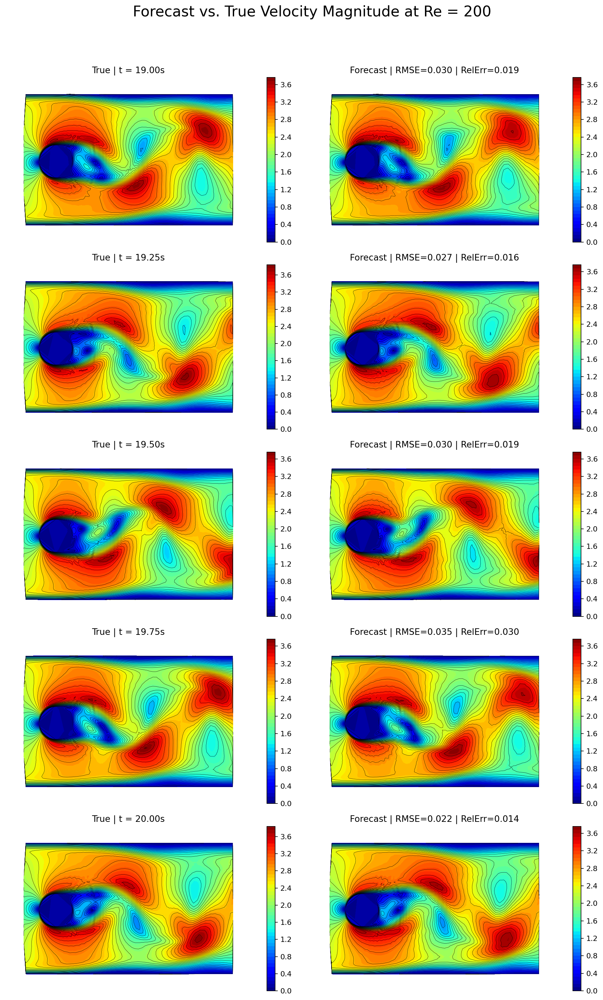

In [124]:
# Parameters
Re_query = 200           # Must be one of the trained Reynolds numbers
t_start = 19.0           # Start of time window
t_end = 20.0             # End of time window
granularity = 5         # Sample every nth time step

# Forecast using trained DMD model
forecast_field, t_forecast = forecast_trained_velocity_fields(
    Re_query_val=Re_query,
    stabilized_models=stabilized_models,
    pod=pod,
    sampled_times_future_dict=sampled_times_future_dict,
    sampled_times_dict=sampled_times_dict
)

# Validate input
if Re_query not in stabilized_models:
    raise ValueError(f"Re = {Re_query} is not a trained Reynolds number. Choose from: {list(stabilized_models.keys())}")

# Load true field and time grid
true_field = snapshot_future_dict.get(Re_query, None)
true_times = [float(t) for t in sampled_times_future_dict.get(Re_query, [])]

if true_field is None or not true_times:
    raise ValueError(f"No true field available for Re = {Re_query} in future snapshot dictionary.")

# Check time range validity
max_true_time = max(true_times)
max_forecast_time = max(t_forecast)
if t_end > max_true_time or t_end > max_forecast_time:
    raise ValueError(f"Requested t_end = {t_end} exceeds available data range. "
                     f"Max true time = {max_true_time}, Max forecast time = {max_forecast_time}")

# Time normalization
t0 = float(sampled_times_dict[Re_query][0])
dt = float(sampled_times_dict[Re_query][1]) - t0
filtered_times = [t for t in true_times if t_start <= t <= t_end][::granularity]
normalized_times = [(t - t0) / dt for t in filtered_times]

# Spatial setup
num_points = num_points_dict[Re_query]
coords = loader_dict[Re_query].vertices[mask_dict[Re_query].numpy(), :]
triang = mtri.Triangulation(coords[:, 0], coords[:, 1])

# Plot setup
fig, axes = plt.subplots(len(filtered_times), 2, figsize=(12, 4 * len(filtered_times)))
fig.suptitle(f"Forecast vs. True Velocity Magnitude at Re = {Re_query}", fontsize=20)

for row, (t, tau) in enumerate(zip(filtered_times, normalized_times)):
    i = true_times.index(t)

    # True field
    u_x_true = true_field[:num_points, i]
    u_y_true = true_field[num_points:, i]
    mag_true = np.sqrt(u_x_true**2 + u_y_true**2)

    # Forecasted field
    u_x_forecast = forecast_field[:num_points, i]
    u_y_forecast = forecast_field[num_points:, i]
    mag_forecast = np.sqrt(u_x_forecast**2 + u_y_forecast**2)

    # Error metrics
    mag_err = np.abs(mag_true - mag_forecast)
    rmse = np.sqrt(np.mean(mag_err**2))
    rel_err = np.mean(mag_err / (mag_true + 1e-8))

    print(f"t = {t:.2f}s | RMSE = {rmse:.4f} | RelErr = {rel_err:.4f}")

    # Plot true field
    ax_true = axes[row, 0]
    contour_true = ax_true.tricontourf(triang, mag_true, levels=50, cmap="jet")
    ax_true.tricontour(triang, mag_true, levels=30, linewidths=0.3, colors='k')
    ax_true.set_title(f"True | t = {t:.2f}s", fontsize=12)
    ax_true.axis('equal')
    ax_true.axis('off')
    fig.colorbar(contour_true, ax=ax_true)

    # Plot forecasted field
    ax_forecast = axes[row, 1]
    contour_forecast = ax_forecast.tricontourf(triang, mag_forecast, levels=50, cmap="jet")
    ax_forecast.tricontour(triang, mag_forecast, levels=30, linewidths=0.3, colors='k')
    ax_forecast.set_title(f"Forecast | RMSE={rmse:.3f} | RelErr={rel_err:.3f}", fontsize=12)
    ax_forecast.axis('equal')
    ax_forecast.axis('off')
    fig.colorbar(contour_forecast, ax=ax_forecast)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


## Forecasting, interpolation and visualization for the untested Reynolds numbers

## Interpolation using POD coefficients (reduced snapshots)

In [125]:
from ezyrb import Database, RBF, GPR, Linear
import numpy as np

# Step 1: Forecast reduced snapshots for each trained Re over 10–20s
reduced_forecasts = {}  # {Re: np.ndarray of shape (r, T)}

# Reference time step info from any trained Re
t0 = float(sampled_times_dict[Re_list[0]][0])
dt = float(sampled_times_dict[Re_list[0]][1]) - t0

# Build combined time grid (convert to float to avoid TypeError)
loader_ref = loader_dict[Re_list[0]]
sampled_times_combined = [
    float(t) for t in loader_ref.write_times
    if 10.0 <= float(t) <= 20.0
][::sampling_step]

for Re in Re_list:
    Phi, Lambda, b = stabilized_models[Re]
    omega = np.log(Lambda) / dt
    coeffs_time = np.column_stack([
        b * np.exp(omega * (t - t0))
        for t in sampled_times_combined
    ])  # shape (r_modes, T)
    x_hat = np.real(Phi @ coeffs_time)  # reduced snapshots
    reduced_forecasts[Re] = x_hat

# Step 2: Interpolate reduced snapshots across Re for each time step
Re_train = np.array(Re_list).reshape(-1, 1)
Re_query_val = 500
Re_query = np.array([[Re_query_val]])

interpolators = {
    "RBF": RBF(),
    "GPR": GPR(),
    "Linear": Linear()
}

forecast_results = {}  # {name: full_field_forecast}

for name, interpolator in interpolators.items():
    reduced_query = []

    for t_idx in range(len(sampled_times_combined)):
        # Stack reduced snapshots for all Re at this time index
        Y = np.vstack([
            reduced_forecasts[Re][:, t_idx]
            for Re in Re_list
        ])  # shape (n_Re, r)
        db = Database(Re_train, Y)
        interpolator.fit(db.parameters_matrix, db.snapshots_matrix)

        # Force to 1D vector of length r
        x_query = interpolator.predict(Re_query).reshape(-1)
        reduced_query.append(x_query)

    # Now reduced_query is list of (r,) → shape (r, T) after stacking
    X_query = np.column_stack(reduced_query)  # shape (r, T)
    full_field_forecast = pod.inverse_transform(X_query)  # shape (2*num_points, T)
    forecast_results[name] = full_field_forecast
    print(f"{name} forecast at Re={Re_query_val} over {len(sampled_times_combined)} time steps: shape {full_field_forecast.shape}")


RBF forecast at Re=500 over 201 time steps: shape (11492, 201)
GPR forecast at Re=500 over 201 time steps: shape (11492, 201)
Linear forecast at Re=500 over 201 time steps: shape (11492, 201)


## Visualize true vs reconstructed velocity magnitude for the "unseen parameters"

In [126]:
# Define path and loader
Re_test = 500
path_test = "/home/haseeb/OpenFOAM/run/cylinder_2D_Re500"
sampling_step_test = 5  # Adjust as needed

# Initialize loader
loader_test = FOAMDataloader(path_test)
times_test = loader_test.write_times

# Define time windows
window_times_test = [t for t in times_test if 10.0 <= float(t) <= 20.0]
sampled_times_test = window_times_test[::sampling_step_test]

# Create spatial mask for cylinder region
vertices_test = loader_test.vertices[:, :2]
mask_test = mask_box(vertices_test, lower=[0.1, -1], upper=[0.75, 1])

# Load masked velocity snapshots
def load_masked_matrix(loader, mask, times):
    num_points = mask.sum().item()
    num_times = len(times)
    data_matrix = pt.zeros((2 * num_points, num_times), dtype=pt.float64)

    for i, time in enumerate(times):
        snapshot = loader.load_snapshot("U", time)
        ux_masked = pt.masked_select(snapshot[:, 0], mask)
        uy_masked = pt.masked_select(snapshot[:, 1], mask)
        data_matrix[:num_points, i] = ux_masked
        data_matrix[num_points:, i] = uy_masked

    return data_matrix.numpy(), num_points

snapshot_test, num_points_test = load_masked_matrix(loader_test, mask_test, sampled_times_test)

# Confirm shape
print(f"Loaded true snapshots for Re = {Re_test}: {snapshot_test.shape}")


INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant


Loaded true snapshots for Re = 500: (11492, 201)


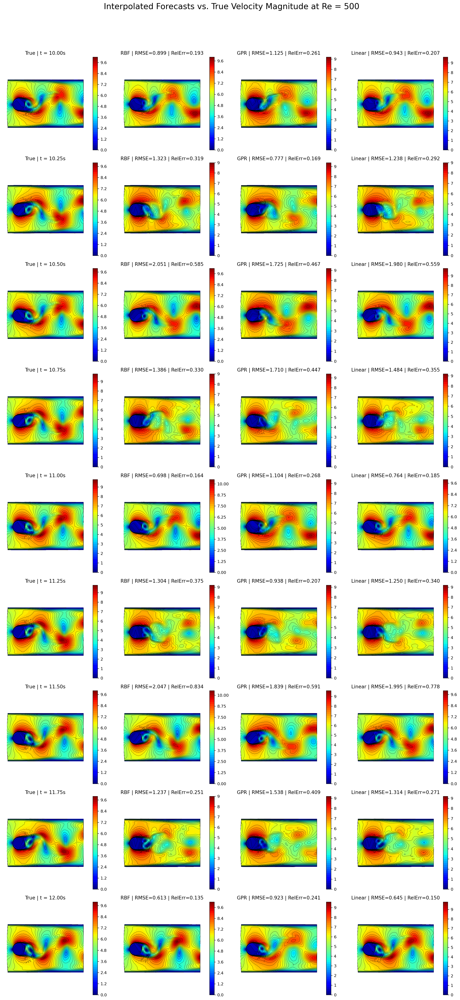

In [127]:
# Time filtering
t_start = 10.0           # Start of time window
t_end = 12.0             # End of time window
granularity = 5         # Sample every nth time step

# Filter time steps
filtered_times_test = [float(t) for t in sampled_times_test if t_start <= float(t) <= t_end][::granularity]
t0_test = float(sampled_times_test[0])
dt_test = float(sampled_times_test[1]) - t0_test
normalized_times_test = [(t - t0_test) / dt_test for t in filtered_times_test]

# Spatial setup
coords_test = loader_test.vertices[mask_test.numpy(), :]
triang_test = mtri.Triangulation(coords_test[:, 0], coords_test[:, 1])

# Plot setup
num_models = len(forecast_results)
fig, axes = plt.subplots(len(filtered_times_test), num_models + 1, figsize=(4 * (num_models + 1), 4 * len(filtered_times_test)))
fig.suptitle(f"Interpolated Forecasts vs. True Velocity Magnitude at Re = {Re_test}", fontsize=20)

for row, (t, tau) in enumerate(zip(filtered_times_test, normalized_times_test)):
    i = next(idx for idx, val in enumerate(sampled_times_test) if abs(float(val) - t) < 1e-6)
  # Ensure index matches original time format

    # True field
    u_x_true = snapshot_test[:num_points_test, i]
    u_y_true = snapshot_test[num_points_test:, i]
    mag_true = np.sqrt(u_x_true**2 + u_y_true**2)

    # Plot true field
    ax_true = axes[row, 0]
    contour_true = ax_true.tricontourf(triang_test, mag_true, levels=50, cmap="jet")
    ax_true.tricontour(triang_test, mag_true, levels=30, linewidths=0.3, colors='k')
    ax_true.set_title(f"True | t = {t:.2f}s", fontsize=12)
    ax_true.axis('equal')
    ax_true.axis('off')
    fig.colorbar(contour_true, ax=ax_true)

    # Plot each interpolated forecast
    for col, (name, forecast_field) in enumerate(forecast_results.items(), start=1):
        u_x_forecast = forecast_field[:num_points_test, i]
        u_y_forecast = forecast_field[num_points_test:, i]
        mag_forecast = np.sqrt(u_x_forecast**2 + u_y_forecast**2)

        # Error metrics
        mag_err = np.abs(mag_true - mag_forecast)
        rmse = np.sqrt(np.mean(mag_err**2))
        rel_err = np.mean(mag_err / (mag_true + 1e-8))

        ax_forecast = axes[row, col]
        contour_forecast = ax_forecast.tricontourf(triang_test, mag_forecast, levels=50, cmap="jet")
        ax_forecast.tricontour(triang_test, mag_forecast, levels=30, linewidths=0.3, colors='k')
        ax_forecast.set_title(f"{name} | RMSE={rmse:.3f} | RelErr={rel_err:.3f}", fontsize=12)
        ax_forecast.axis('equal')
        ax_forecast.axis('off')
        fig.colorbar(contour_forecast, ax=ax_forecast)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


In [128]:
from ezyrb import Database, RBF, GPR, Linear
import numpy as np

# Common timing
t0 = float(sampled_times_dict[Re_list[0]][0])
dt = float(sampled_times_dict[Re_list[0]][1]) - t0

# Build combined time grid
loader_ref = loader_dict[Re_list[0]]
sampled_times_combined = [float(t) for t in loader_ref.write_times if 10.0 <= float(t) <= 20.0][::sampling_step]
T = len(sampled_times_combined)

# Collect spectral values and amplitudes for all trained Re
Re_train = np.array(Re_list).reshape(-1, 1)
r_modes = stabilized_models[Re_list[0]][0].shape[1]

omega_real = np.zeros((len(Re_list), r_modes))
omega_imag = np.zeros((len(Re_list), r_modes))
b_real     = np.zeros((len(Re_list), r_modes))
b_imag     = np.zeros((len(Re_list), r_modes))

for i, Re in enumerate(Re_list):
    Phi, Lambda, b = stabilized_models[Re]
    omega = np.log(Lambda) / dt  # continuous-time eigenvalues
    omega_real[i, :] = np.real(omega)
    omega_imag[i, :] = np.imag(omega)
    b_real[i, :]     = np.real(b)
    b_imag[i, :]     = np.imag(b)

# Interpolate ω and b across Re
interpolators = {
    "RBF": RBF(),
    "GPR": GPR(),
    "Linear": Linear()
}

Re_query_val = 500
Re_query = np.array([[Re_query_val]])
forecast_results = {}

for name, interpolator in interpolators.items():
    omega_r_pred = np.zeros(r_modes)
    omega_i_pred = np.zeros(r_modes)
    b_r_pred     = np.zeros(r_modes)
    b_i_pred     = np.zeros(r_modes)

    for k in range(r_modes):
        # ω real
        db = Database(Re_train, omega_real[:, k:k+1])
        interpolator.fit(db.parameters_matrix, db.snapshots_matrix)
        omega_r_pred[k] = interpolator.predict(Re_query)

        # ω imag
        db = Database(Re_train, omega_imag[:, k:k+1])
        interpolator.fit(db.parameters_matrix, db.snapshots_matrix)
        omega_i_pred[k] = interpolator.predict(Re_query)

        # b real
        db = Database(Re_train, b_real[:, k:k+1])
        interpolator.fit(db.parameters_matrix, db.snapshots_matrix)
        b_r_pred[k] = interpolator.predict(Re_query)

        # b imag
        db = Database(Re_train, b_imag[:, k:k+1])
        interpolator.fit(db.parameters_matrix, db.snapshots_matrix)
        b_i_pred[k] = interpolator.predict(Re_query)

    omega_query = omega_r_pred + 1j * omega_i_pred
    b_query     = b_r_pred + 1j * b_i_pred

    # Choose reconstruction basis Φ
    Re_ref = min(Re_list, key=lambda r: abs(r - Re_query_val))
    Phi_ref, _, _ = stabilized_models[Re_ref]

    # Forecast in time using interpolated ω and b
    reduced_series = np.zeros((Phi_ref.shape[0], T), dtype=np.complex128)
    for j, t in enumerate(sampled_times_combined):
        a_t = b_query * np.exp(omega_query * (t - t0))
        reduced_series[:, j] = Phi_ref @ a_t

    # Reconstruct full field
    full_field_forecast = pod.inverse_transform(np.real(reduced_series))
    forecast_results[name] = full_field_forecast
    print(f"{name} spectral-interp forecast at Re={Re_query_val}: shape {full_field_forecast.shape}")


ValueError: could not broadcast input array from shape (17,) into shape (13,)

In [ ]:
# Time filtering
t_start = 10.0           # Start of time window
t_end = 11.0             # End of time window
granularity = 10         # Sample every nth time step

# Filter time steps
filtered_times_test = [float(t) for t in sampled_times_test if t_start <= float(t) <= t_end][::granularity]
t0_test = float(sampled_times_test[0])
dt_test = float(sampled_times_test[1]) - t0_test
normalized_times_test = [(t - t0_test) / dt_test for t in filtered_times_test]

# Spatial setup
coords_test = loader_test.vertices[mask_test.numpy(), :]
triang_test = mtri.Triangulation(coords_test[:, 0], coords_test[:, 1])

# Plot setup
num_models = len(forecast_results)  # from spectral interpolation
fig, axes = plt.subplots(len(filtered_times_test), num_models + 1,
                         figsize=(4 * (num_models + 1), 4 * len(filtered_times_test)))
fig.suptitle(f"Spectral Interpolation Forecasts vs. True Velocity Magnitude at Re = {Re_test}",
             fontsize=20)

for row, (t, tau) in enumerate(zip(filtered_times_test, normalized_times_test)):
    # Find index in original time array
    i = next(idx for idx, val in enumerate(sampled_times_test) if abs(float(val) - t) < 1e-6)

    # True field
    u_x_true = snapshot_test[:num_points_test, i]
    u_y_true = snapshot_test[num_points_test:, i]
    mag_true = np.sqrt(u_x_true**2 + u_y_true**2)

    # Plot true field
    ax_true = axes[row, 0]
    contour_true = ax_true.tricontourf(triang_test, mag_true, levels=50, cmap="jet")
    ax_true.tricontour(triang_test, mag_true, levels=30, linewidths=0.3, colors='k')
    ax_true.set_title(f"True | t = {t:.2f}s", fontsize=12)
    ax_true.axis('equal')
    ax_true.axis('off')
    fig.colorbar(contour_true, ax=ax_true)

    # Plot each spectral-interpolated forecast
    for col, (name, forecast_field) in enumerate(forecast_results.items(), start=1):
        u_x_forecast = forecast_field[:num_points_test, i]
        u_y_forecast = forecast_field[num_points_test:, i]
        mag_forecast = np.sqrt(u_x_forecast**2 + u_y_forecast**2)

        # Error metrics
        mag_err = np.abs(mag_true - mag_forecast)
        rmse = np.sqrt(np.mean(mag_err**2))
        rel_err = np.mean(mag_err / (mag_true + 1e-8))

        ax_forecast = axes[row, col]
        contour_forecast = ax_forecast.tricontourf(triang_test, mag_forecast, levels=50, cmap="jet")
        ax_forecast.tricontour(triang_test, mag_forecast, levels=30, linewidths=0.3, colors='k')
        ax_forecast.set_title(f"{name} | RMSE={rmse:.3f} | RelErr={rel_err:.3f}", fontsize=12)
        ax_forecast.axis('equal')
        ax_forecast.axis('off')
        fig.colorbar(contour_forecast, ax=ax_forecast)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()
